Blurred image shape: torch.Size([1, 3, 120, 120])


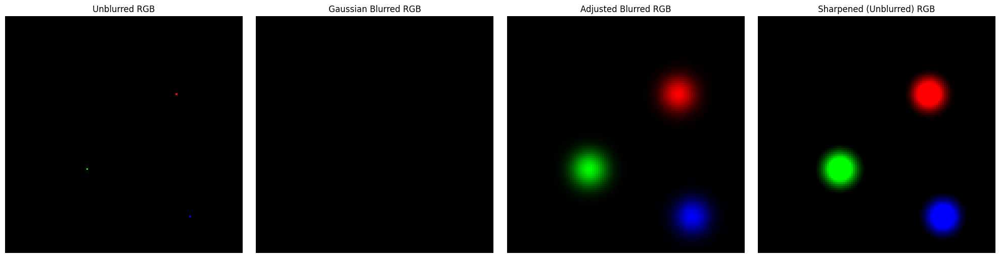

In [1]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# ================== Part 1: Create a Synthetic Unblurred RGB Image =====================
# Create an unblurred RGB tensor with shape: (batch_size=1, channels=3, height=240, width=240)
unblurred = torch.zeros((1, 3, 120, 120))
# Place a "1" in each channel at different locations
unblurred[0, 0, 39, 86] = 1.0   # Red channel
unblurred[0, 1, 77, 41] = 1.0   # Green channel
unblurred[0, 2, 101, 93] = 1.0  # Blue channel

# ================== Part 2: Create a Gaussian Kernel and Blur the Image ==================
def get_gaussian_kernel(kernel_size=3, sigma=1.0):
    # Create a coordinate grid centered at zero.
    ax = torch.arange(kernel_size, dtype=torch.float32) - kernel_size // 2
    xx, yy = torch.meshgrid(ax, ax, indexing='ij')
    kernel = torch.exp(-(xx**2 + yy**2) / (2 * sigma**2))
    return kernel / kernel.sum()

# Define parameters for the heavy Gaussian blur.
sigma_blur = 6
kernel_size_blur = 10 * sigma_blur + 1  # e.g., 301 if sigma_blur = 30
gaussian_kernel = get_gaussian_kernel(kernel_size_blur, sigma_blur)  # shape: (kernel_size_blur, kernel_size_blur)

# Expand the kernel to shape (channels, 1, kernel_size, kernel_size) so each channel uses the same kernel.
gaussian_kernel = gaussian_kernel.expand(3, 1, kernel_size_blur, kernel_size_blur)

# Pad the unblurred tensor to preserve spatial dimensions after convolution.
padded_unblurred = F.pad(unblurred, (kernel_size_blur//2,)*4, mode='constant')

# Apply Gaussian blur via convolution (groups=3 to process each channel separately)
blurred = F.conv2d(padded_unblurred, gaussian_kernel, groups=3)
print("Blurred image shape:", blurred.shape)

# ================== Part 3: Adjust the Blurred Image ==================
# For each channel, find the maximum value and compute a scaling factor so the max becomes 1.
max_info = []  # To store (channel, x, y, max_value, scaling factor)
adjusted_blurred = blurred.clone()

adjusted_blurred/=torch.max(blurred)

# ================== Part 4: Define a Negative Gaussian Kernel Generator for Sharpening ==================
def get_negative_gaussian_kernel(kernel_size=31, sigma=5.0, amount=1.0):
    """
    Returns a sharpening kernel computed as:
      sharpen_kernel = (1 + amount)*delta - amount*G,
    where G is a normalized Gaussian kernel and delta is a kernel with 1 at the center.
    The kernel sums to 1.
    """
    # Get a normalized Gaussian kernel.
    G = get_gaussian_kernel(kernel_size, sigma)
    # Create delta kernel.
    delta = torch.zeros_like(G)
    center = kernel_size // 2
    delta[center, center] = 1.0
    # Compute the sharpen kernel.
    kernel = (1 + amount) * delta - amount * G
    return kernel

# Choose parameters for the negative Gaussian kernel (larger kernel than 3x3)
kernel_size_sharp = 31   # a larger kernel size for broader sharpening
sigma_sharp = 5.0        # sigma for the Gaussian used in sharpening
amount = 2.0             # strength of the sharpening effect

sharp_kernel = get_negative_gaussian_kernel(kernel_size_sharp, sigma_sharp, amount)
# Expand the kernel for each channel (shape: (3, 1, kernel_size_sharp, kernel_size_sharp))
sharp_kernel = sharp_kernel.expand(3, 1, kernel_size_sharp, kernel_size_sharp)

# ================== Part 5: Apply the Negative Gaussian Sharpening Kernel ==================
# Pad the adjusted blurred image appropriately (using reflection to avoid edge artifacts)
padded_adjusted = F.pad(adjusted_blurred, (kernel_size_sharp//2,)*4, mode='reflect')
# Convolve with the negative Gaussian kernel to "unblur" (sharpen) the image.
unblurred_again = F.conv2d(padded_adjusted, sharp_kernel, groups=3)

# ================== Part 6: Convert Tensors to NumPy Arrays for Plotting ==================
# Convert tensors from (B, C, H, W) to (H, W, C)
def to_numpy(tensor):
    return tensor.squeeze(0).permute(1, 2, 0).detach().cpu().numpy()

unblurred_rgb         = to_numpy(unblurred)
blurred_rgb           = to_numpy(blurred)
adjusted_blurred_rgb  = to_numpy(adjusted_blurred)
unblurred_again_rgb   = to_numpy(unblurred_again)

# Optionally clip values for display
unblurred_rgb         = np.clip(unblurred_rgb, 0, 1)
blurred_rgb           = np.clip(blurred_rgb, 0, 1)
adjusted_blurred_rgb  = np.clip(adjusted_blurred_rgb, 0, 1)
unblurred_again_rgb   = np.clip(unblurred_again_rgb, 0, 1)

# ================== Part 7: Print Max Info ==================
for ch, x, y, max_val, scaling in max_info:
    print(f"Channel {ch}: Max at (x={x}, y={y}) with value {max_val:.4f}; scaling factor: {scaling:.4f}")

# ================== Part 8: Plot All Results Side by Side ==================
fig, axes = plt.subplots(1, 4, figsize=(20, 5))

axes[0].imshow(unblurred_rgb)
axes[0].set_title('Unblurred RGB')
axes[0].axis('off')

axes[1].imshow(blurred_rgb)
axes[1].set_title('Gaussian Blurred RGB')
axes[1].axis('off')

axes[2].imshow(adjusted_blurred_rgb)
axes[2].set_title('Adjusted Blurred RGB')
axes[2].axis('off')

axes[3].imshow(unblurred_again_rgb)
axes[3].set_title('Sharpened (Unblurred) RGB')
axes[3].axis('off')

plt.tight_layout()
plt.show()

In [2]:

import torch
import torch.nn as nn
import torchvision.models as models

class PoseResNet(nn.Module):
    def __init__(self, num_deconv_layers=4, 
                 num_deconv_filters=[512, 256, 128,128],
                 num_deconv_kernels=[4, 4, 4,4],
                 num_keypoints=17):
        super(PoseResNet, self).__init__()
        # Use a pretrained ResNet-101 as the backbone
        resnet = models.resnet101(pretrained=True)
        self.backbone = nn.Sequential(
            resnet.conv1,
            resnet.bn1,
            resnet.relu,
            resnet.maxpool,
            resnet.layer1,
            resnet.layer2,
            resnet.layer3,
            resnet.layer4
        )
        # Freeze backbone parameters
        for param in self.backbone.parameters():
            param.requires_grad = False

        # Build deconvolution layers
        self.deconv_layers = self._make_deconv_layer(
            num_deconv_layers, num_deconv_filters, num_deconv_kernels)
        
        # Final layer to produce heatmaps for keypoints
        self.final_layer = nn.Conv2d(
            in_channels=num_deconv_filters[-1],
            out_channels=num_keypoints,
            kernel_size=1,
            stride=1,
            padding=0
        )

    def _make_deconv_layer(self, num_layers, num_filters, num_kernels):
        layers = []
        # For ResNet-101, the output channels of the backbone is 2048.
        in_channels = 2048  
        for i in range(num_layers):
            kernel = num_kernels[i]
            out_channels = num_filters[i]
            if kernel == 4:
                padding = 1
                output_padding = 0
            elif kernel == 3:
                padding = 1
                output_padding = 1
            elif kernel == 2:
                padding = 0
                output_padding = 0
            layers.append(nn.ConvTranspose2d(
                in_channels, out_channels, kernel_size=kernel,
                stride=2, padding=padding, output_padding=output_padding, bias=False))
            layers.append(nn.BatchNorm2d(out_channels))
            layers.append(nn.ReLU(inplace=True))
            in_channels = out_channels
        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.backbone(x)
        x = self.deconv_layers(x)
        x = self.final_layer(x)
        return x

# Instantiate the model.
model = PoseResNet()

# Now, the backbone uses the pretrained ResNet-101 weights directly,
# and only the deconv_layers and final_layer will be trainable.
trainable_params = [p for p in model.parameters() if p.requires_grad]
print("Trainable parameters count:", len(trainable_params))


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth
100%|██████████| 171M/171M [00:00<00:00, 201MB/s]  


Trainable parameters count: 14


In [3]:
trainable_params = [p for p in model.parameters() if p.requires_grad]
print("Trainable parameters count:", len(trainable_params))

Trainable parameters count: 14


In [4]:
x=torch.rand((1,3,480,480))
output=model(x)
print(output.shape,output.reshape(1,17,-1).shape)

torch.Size([1, 17, 240, 240]) torch.Size([1, 17, 57600])


In [5]:
criterion = nn.MSELoss(size_average=True)
target=torch.rand(1,17,240,240).reshape(1,17,-1)
reshaped_output=output.reshape(1,17,-1)
print(criterion(reshaped_output,target))

loss=0
for i in range(17):
    loss+=criterion(reshaped_output[:,i,:],target[:,i,:])
print(loss,loss/17)

tensor(0.5389, grad_fn=<MseLossBackward0>)
tensor(9.1621, grad_fn=<AddBackward0>) tensor(0.5389, grad_fn=<DivBackward0>)


/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:51: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


In [6]:

import pandas as pd
import ast  # Safer alternative to eval()

# Sample DataFrame with string-encoded lists

df = pd.read_csv("/kaggle/input/coco-human-keypoints-train-dataset/kaggle/working/train_keypoint_data.csv")

df.head()
# Convert string representation of lists to actual lists
df["keypoints"] = df["keypoints"].apply(ast.literal_eval)  # Safer than eval()

# Function to count ones in the keypoints list
def count_ones(keypoints):
    return sum(1 for i in range(2, len(keypoints), 3) if keypoints[i] == 1)

# Apply function and filter rows
df_filtered = df[df["keypoints"].apply(count_ones) >= 16]

df.head()

df_filtered.head()
len(df),len(df_filtered),type(df_filtered["keypoints"].iloc[0]),type(df_filtered["keypoints"].iloc[0][2])

(149547, 21119, list, int)

In [7]:
class key_loss(nn.Module):
    def __init__(self):
        super().__init__()
        self.criterion=nn.MSELoss(size_average=True)
    def forward(self,predictions,targets):
        batches=predictions.shape[0]
        # target=targets.reshape(batches,17,-1)
        # reshaped_output=predictions.reshape(batches,17,-1)
        # # print(criterion(reshaped_output,target),targets.reshape(batches,17,-1))
        # loss=0
        # for i in range(17):
        #     loss+=criterion(reshaped_output[:,i,:],target[:,i,:])
        # return loss
        if torch.isnan(predictions).any():
            print("Found NaNs inpreds!")
        if torch.isnan(targets).any():
            print("Found NaNs in target!")
        return self.criterion(predictions.reshape(batches,17,-1),targets.reshape(batches,17,-1))*100

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class KeyLoss(nn.Module):
    def __init__(self, beta=100.0, scale_factor=1.0):
        
        super().__init__()
        self.beta = beta
        self.scale_factor = scale_factor
        self.criterion = nn.MSELoss(reduction='mean')

    def soft_argmax_2d(self, heatmap):
        H, W = heatmap.shape
        # Flatten the heatmap and subtract its max for numerical stability.
        flat = heatmap.view(-1)
        flat = flat - flat.max()
        # Apply softmax with temperature beta.
        if torch.isnan(flat).any():
            print("Found NaNs in flat!")
        prob = F.softmax(flat * self.beta, dim=0).view(H, W)
        
        # Create coordinate grids.
        grid_y = torch.linspace(0, H - 1, H, device=heatmap.device).view(H, 1)
        grid_x = torch.linspace(0, W - 1, W, device=heatmap.device).view(1, W)
        
        # Compute expected coordinates as weighted averages.
        x_coord = torch.sum(prob * grid_x)
        y_coord = torch.sum(prob * grid_y)
        return x_coord, y_coord

    def forward(self, predictions, targets):
        """
        Computes the loss as a combination of the soft-argmax Euclidean distance
        between predicted and target keypoint heatmaps and an MSE loss on the raw heatmaps.
        
        Args:
            predictions (Tensor): Predicted heatmaps of shape (B, 17, H, W).
            targets (Tensor): Target heatmaps of shape (B, 17, H, W).

        Returns:
            loss (Tensor): The combined loss.
        """
        B, C, H, W = predictions.shape  # Typically, C = 17 for keypoints.
        total_distance = 0.0
        no_keypoint=0
        # Loop over each item in the batch and each keypoint channel.
        for b in range(B):
            for c in range(C):
                pred_heatmap = predictions[b, c]
                target_heatmap = targets[b, c]
                # print("pred")
                # Compute differentiable coordinates using soft-argmax.
                pred_x, pred_y = self.soft_argmax_2d(pred_heatmap)
                if torch.max(target_heatmap)==0:
                    if torch.max(pred_heatmap)>=0:
                        no_keypoint+=torch.abs(torch.sum(pred_heatmap))
                    
                # print("target")
                target_x, target_y = self.soft_argmax_2d(target_heatmap)
                
                # Compute the Euclidean distance with a small epsilon for stability.
                distance = torch.sqrt((pred_x - target_x) ** 2 + (pred_y - target_y) ** 2 + 1e-6)
                total_distance += distance

        # Average the distance loss over all channels and batch items.
        avg_distance_loss = total_distance / (B * C)
        # print(avg_distance_loss)
        # Compute the MSE loss on the flattened heatmaps.
        mse_loss = self.criterion(predictions.reshape(B, C, -1) * 10, targets.reshape(B, C, -1) * 10)
        # print(mse_loss)
        # Combine the losses (scaling the distance loss if desired).
        return self.scale_factor * avg_distance_loss + mse_loss+no_keypoint/(B*C)

In [9]:
from PIL import Image
import torchvision.transforms as transforms
class human_dataset(torch.utils.data.Dataset):
    def __init__(self,dataset_pd,image_path,target_size,sigma=1):
        super().__init__()
        self.target_size=target_size
        kernel_size=sigma*10+1
        self.kernel_size=kernel_size
        self.image_path=image_path
        self.dataset_pd=dataset_pd
        self.transform = transforms.Compose([
            transforms.ToTensor()  # Converts (H, W, C) → (C, H, W) & scales [0,255] → [0,1]
        ])
        gaussian_kernel = get_gaussian_kernel(kernel_size, sigma)  # shape: (kernel_size, kernel_size)

        self.gaussian_kernel = gaussian_kernel.expand(17, 1, kernel_size, kernel_size)
        
        
    def __len__(self):
        return len(self.dataset_pd)
        # return 65
    def __getitem__(self,idx):
        img=Image.open(self.image_path+"/"+self.dataset_pd['image_id'].iloc[idx]).convert("RGB")
        img=self.transform(img)
        keypoints=self.dataset_pd["keypoints"].iloc[idx]
        target=torch.zeros((17,self.target_size,self.target_size))
        # need to turn the img to a tensor 
        # print(type(keypoints))
        for i in range(17):
            if keypoints[i*3+2]==1:
                target[i,int((keypoints[i*3]*(self.target_size-1))//480),int((keypoints[i*3+1]*(self.target_size-1))//480)]=1
        # code for the blur
        padded_unblurred = F.pad(target, (self.kernel_size//2,)*4, mode='constant')
        target = F.conv2d(padded_unblurred, self.gaussian_kernel, groups=17)
        

        scaling = 1 / (torch.max(target)+1e-6)
        # print(scaling)
        target*=scaling
        return img,target

In [10]:
def custom_collate_fn(batch):
    """
    Custom collate function to handle batch processing.
    """
    images, targets = zip(*batch)  # Unzipping batch into separate lists

    # Stack images into a single tensor of shape (batch_size, C, H, W)
    images = torch.stack(images, dim=0)

    # Stack targets (10x10 grids) into a single tensor of shape (batch_size, 10, 10)
    targets = torch.stack(targets, dim=0)

    return images, targets
import pandas as pd
dataset_pd=pd.read_csv("/kaggle/input/coco-human-keypoints-train-dataset/kaggle/working/train_keypoint_data.csv")
dataset = human_dataset(df_filtered,"/kaggle/input/coco-human-keypoints-train-dataset/kaggle/working/train_images",240,6)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=60, shuffle=True, collate_fn=custom_collate_fn, num_workers=4)

In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from tqdm import tqdm  # progress bar


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if torch.cuda.device_count() > 1:
    print("Using", torch.cuda.device_count(), "GPUs!")
    model = nn.DataParallel(model)
model.to(device)
# model = DummyModel(num_keypoints=17, target_size=10).to(device)
criterion = KeyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.8e-2)

num_epochs = 10
reduce=0.1e-4


Using 2 GPUs!


In [12]:
# Load the model and optimizer state
def load_model(filename="checkpoint.pth"):
    checkpoint = torch.load(filename)
    model.load_state_dict(checkpoint["model_state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
    return checkpoint["epoch"] 
 
# Save the model and optimizer state
def save_checkpoint(state, filename="checkpoint.pth"):
    torch.save(state, filename)

# Function to save model and optimizer state
def save_model(epoch, model, optimizer, filename="checkpoint.pth"):
    checkpoint = {
        "epoch": epoch, 
        "model_state_dict": model.state_dict(), 
        "optimizer_state_dict": optimizer.state_dict()
    }
    save_checkpoint(checkpoint, filename) 
    print("done")

# Later, to load the model for further training or inference
epoch_loaded = load_model("checkpoint.pth")

<ipython-input-12-c68025ffd53d>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(filename)


In [13]:
# for param_group in optimizer.param_groups:
#     param_group['lr'] =0.7e-3
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    # Create a tqdm progress bar for the DataLoader
    pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")
    
    for idx,(batch_images, batch_targets) in enumerate(pbar):
        batch_images = batch_images.to(device)
        batch_targets = batch_targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(batch_images)
        loss = criterion(outputs, batch_targets)
        loss.backward()
        optimizer.step()
        # if epoch==0 and idx==500:
        #     for param_group in optimizer.param_groups:
        #         param_group['lr'] =1e-3
        running_loss += loss.item() 
        # Compute mean loss so far
        pbar.set_postfix({"loss": f"{running_loss/(idx+1)}"})
        del batch_images 
        del batch_targets 
        del outputs
            
        for param_group in optimizer.param_groups:
            param_group['lr'] -=reduce/150
    if epoch<=3:
        for param_group in optimizer.param_groups:
            param_group['lr'] -=2e-3
    
    save_model(1,model,optimizer,"checkpoint2.pth")

Epoch 1/10: 100%|██████████| 352/352 [1:12:29<00:00, 12.36s/it, loss=44.38298982923681] 


done


Epoch 2/10:  18%|█▊        | 64/352 [14:08<1:03:39, 13.26s/it, loss=40.081908106803894]


KeyboardInterrupt: 

In [ ]:
import torch 




save_model(1,model,optimizer)


In [15]:
import gc  
optimizer.zero_grad()
# Force garbage collection  
gc.collect() 
torch.cuda.empty_cache()

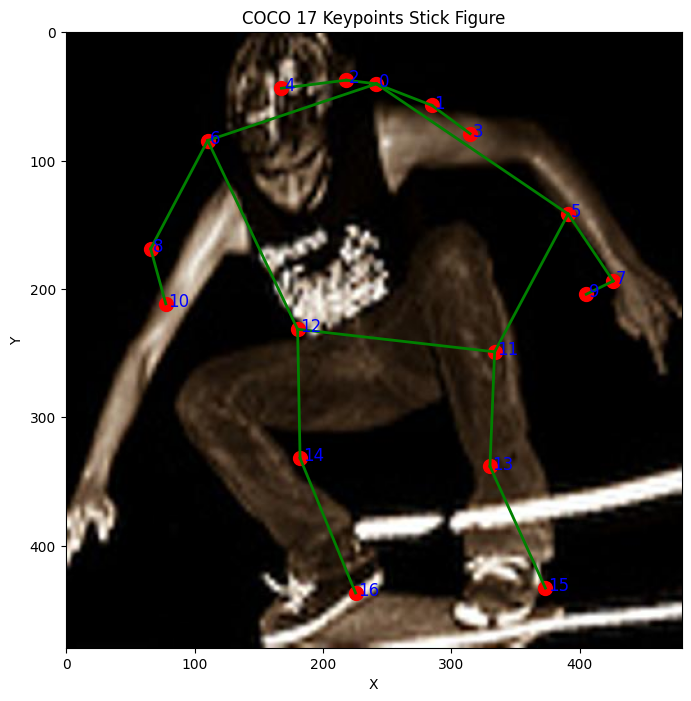

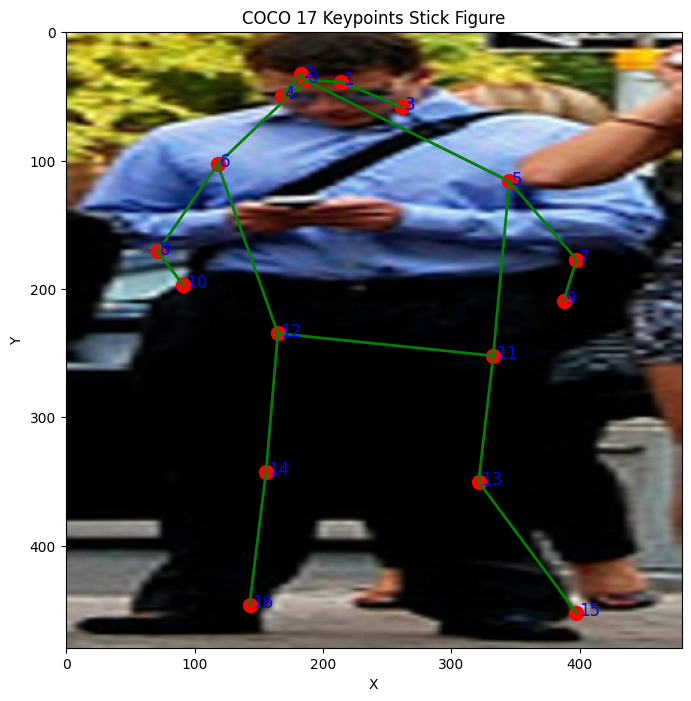

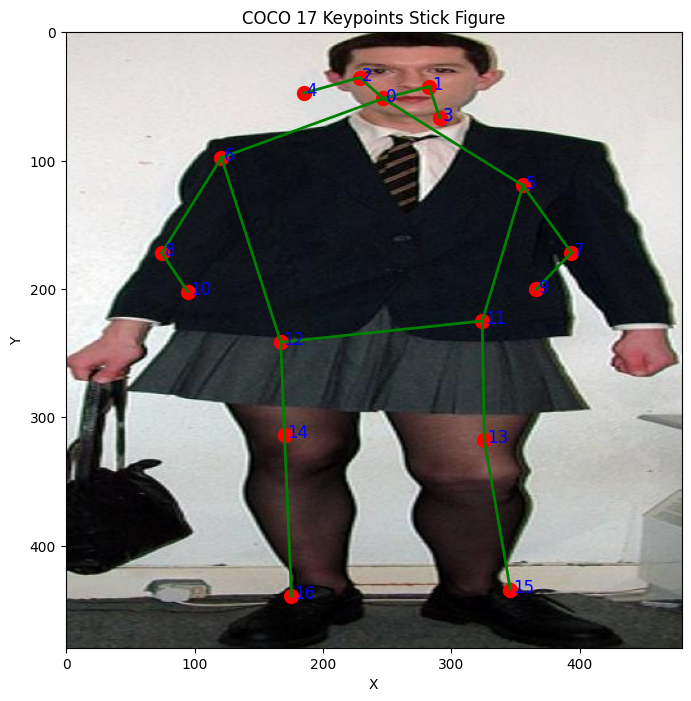

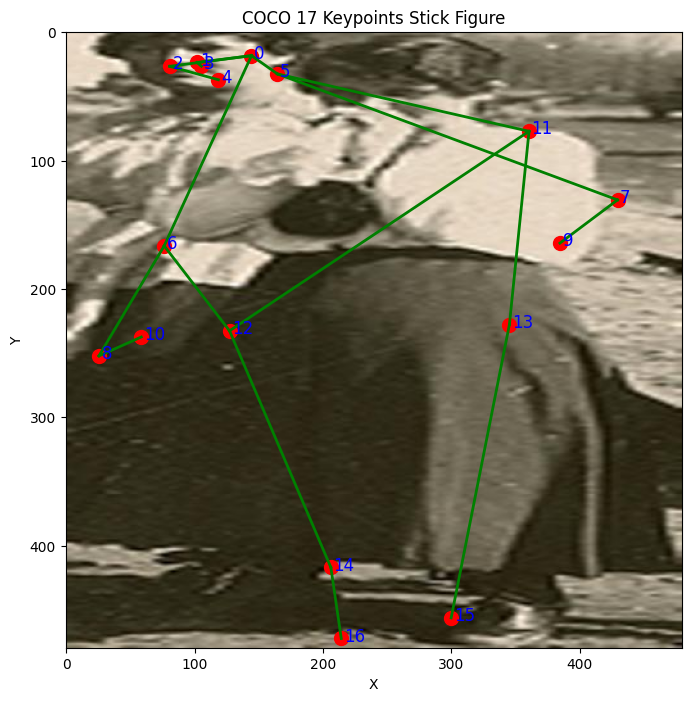

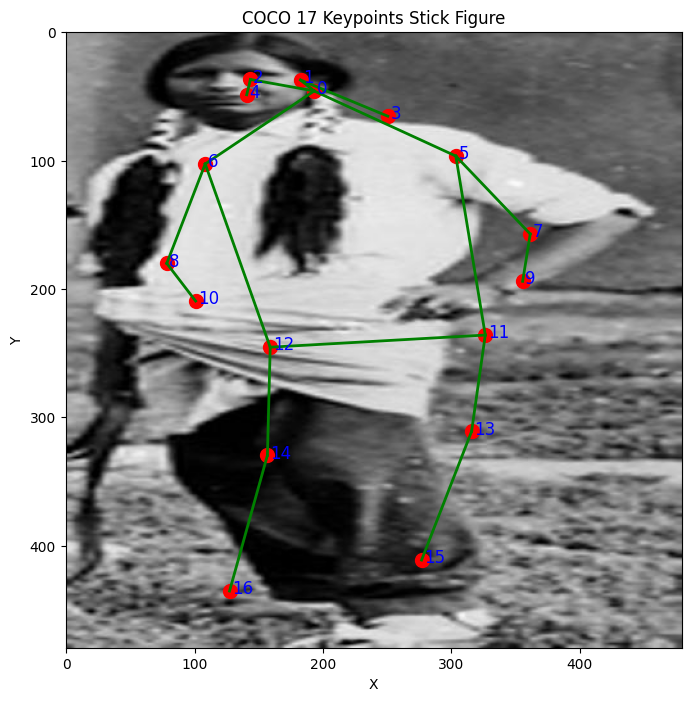

...

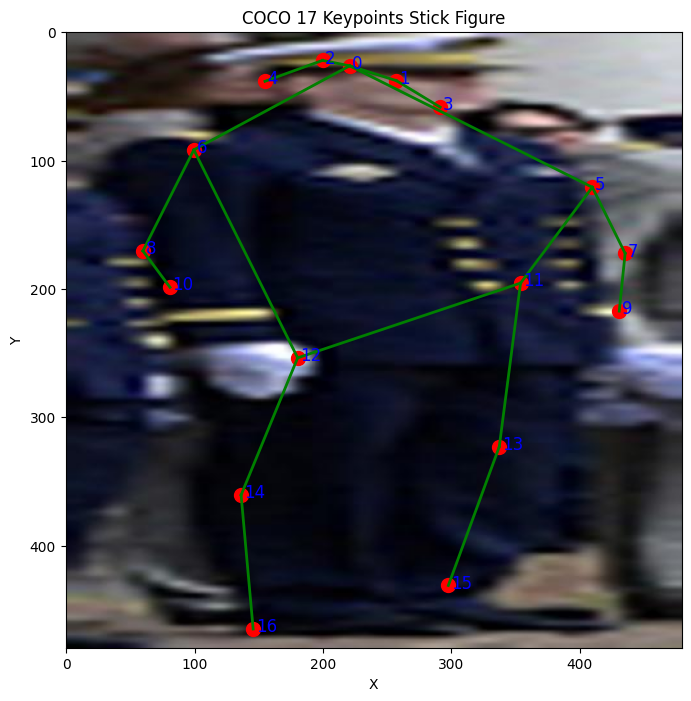

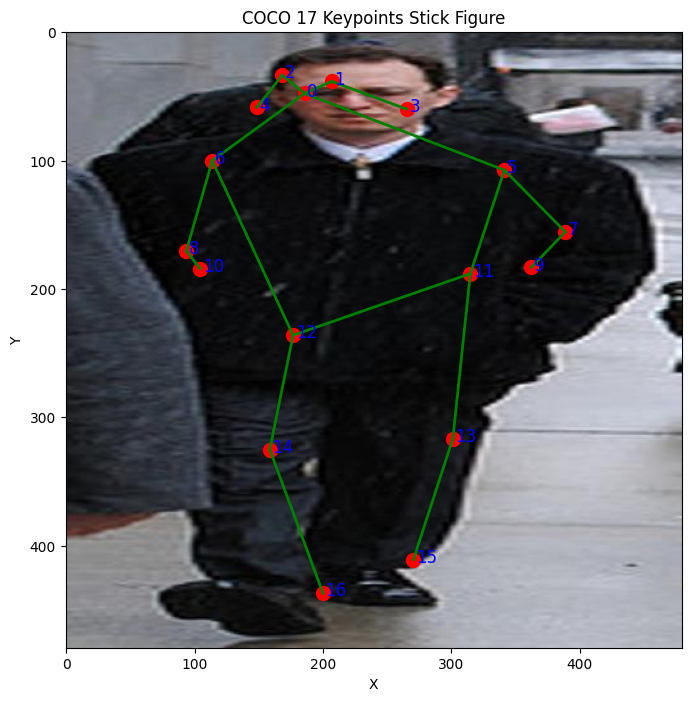

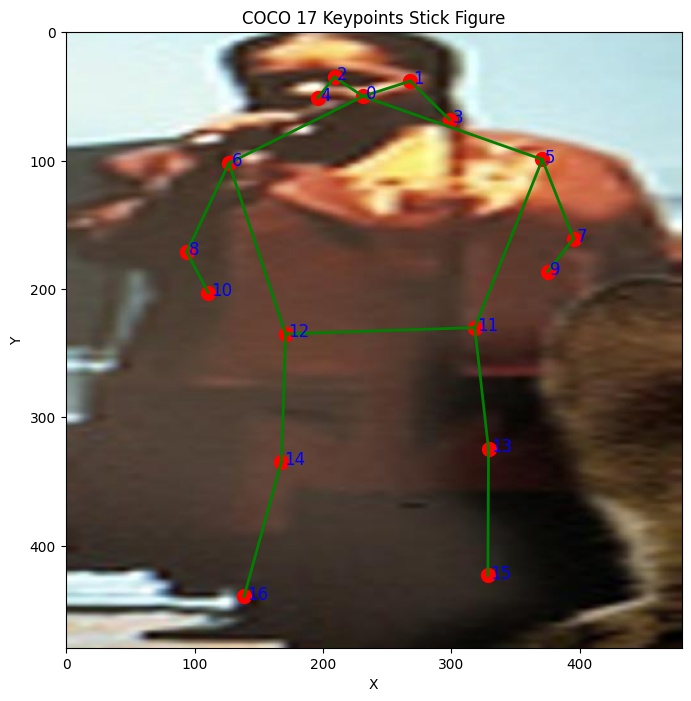

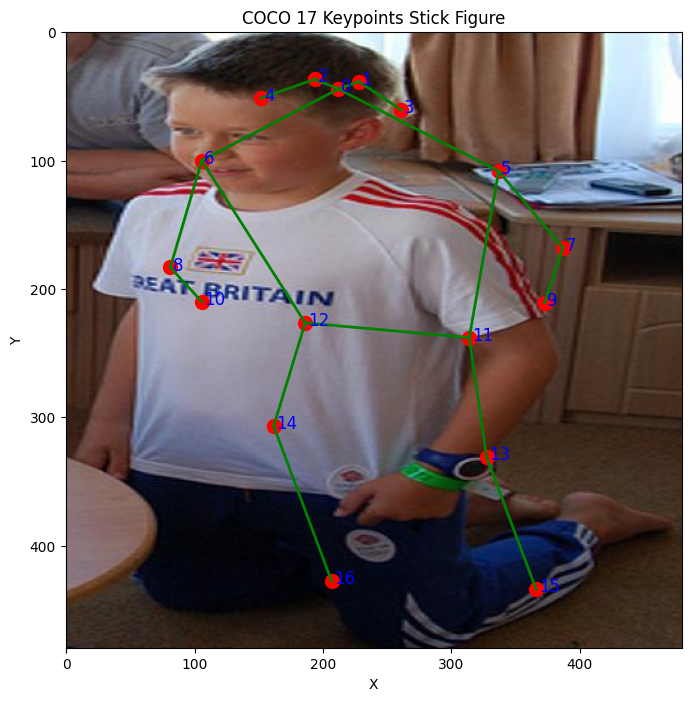

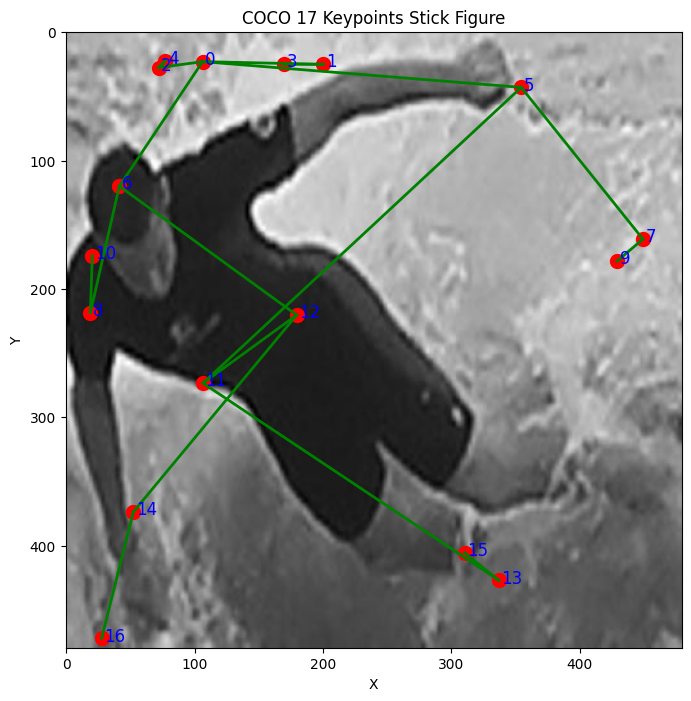

In [16]:
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import random
import torch.nn.functional as F

# --------------------------------------------------
# Setup: Define device, model, and dataset_pd as needed.
# --------------------------------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Example: assume you have defined your model and loaded weights
# from my_model import MyModel
# model = MyModel()
# model.load_state_dict(torch.load('model.pth', map_location=device))
# model.eval()
# model = model.to(device)

# Also assume dataset_pd is a pandas DataFrame containing an 'image_id' column.
# For this example, we'll comment out dataset_pd usage.
# --------------------------------------------------

# --------------------------------------------------
# Load a random image from the dataset.
# --------------------------------------------------
# For demonstration, we use a random integer index.
# In your case, dataset_pd['image_id'] should provide the filename.

for i in range(50):
    dataset_pd=df_filtered
    #need to attach the new pd to the dataset_pd
    idx = random.randint(1, len(dataset_pd))  # dataset_pd assumed to be defined
    img_path = '/kaggle/input/coco-human-keypoints-train-dataset/kaggle/working/train_images/' + dataset_pd["image_id"].iloc[idx] 
    img = Image.open(img_path).convert('RGB')
    img = img.resize((480, 480))
    img_np = np.array(img)
    
    # --------------------------------------------------
    # Transform image to tensor.
    # --------------------------------------------------
    transform = transforms.Compose([
        transforms.ToTensor(),  # Converts (H, W, C) → (C, H, W) and scales [0,255]→[0,1]
        # Add normalization here if needed.
    ])
    img_tensor = transform(img).unsqueeze(0).to(device)  # shape: [1, 3, 480, 480]
    
    # --------------------------------------------------
    # Model Inference.
    # --------------------------------------------------
    with torch.no_grad():
        # Assume the model outputs a tensor of shape [1, 17, 122, 122]
        model_output = model(img_tensor)
    output = model_output[0]  # shape: [17, 122, 122]
    
    # --------------------------------------------------
    # Compute scaling factors.
    # --------------------------------------------------
    num_channels, H, W = output.shape  # Expected: 17, 122, 122
    scale_x = 480 / W
    scale_y = 480 / H
    
    # --------------------------------------------------
    # Define soft-argmax function.
    # --------------------------------------------------
    def soft_argmax_2d(heatmap, beta=10.0):
        """
        Computes a differentiable soft-argmax on a 2D heatmap.
        
        Args:
            heatmap (Tensor): A tensor of shape (H, W)
            beta (float): Temperature parameter to sharpen the softmax distribution.
            
        Returns:
            (x, y): The weighted average coordinates.
        """
        H, W = heatmap.shape
        flat = heatmap.view(-1)
        flat = flat - flat.min()  # Numerical stability
        prob = F.softmax(flat * beta, dim=0).view(H, W)
        
        # Create coordinate grids.
        grid_y = torch.linspace(0, H - 1, H, device=heatmap.device).view(H, 1)
        grid_x = torch.linspace(0, W - 1, W, device=heatmap.device).view(1, W)
        
        x_coord = torch.sum(prob * grid_x)
        y_coord = torch.sum(prob * grid_y)
        return x_coord, y_coord
    
    # --------------------------------------------------
    # Compute keypoint coordinates using soft-argmax.
    # --------------------------------------------------
    max_points = []  # List to store (x, y) coordinates for each of the 17 keypoints.
    for c in range(num_channels):
        y,x = soft_argmax_2d(output[c], beta=100.0)
        x_scaled = x * scale_x
        y_scaled = y * scale_y
        max_points.append((x_scaled, y_scaled))
    
    # --------------------------------------------------
    # Define the COCO skeleton connections (17 keypoints).
    # --------------------------------------------------
    skeleton = [
        (0, 1), (0, 2),       # Nose to eyes
        (1, 3), (2, 4),       # Eyes to ears
        (0, 5), (0, 6),       # Nose to shoulders
        (5, 7), (7, 9),       # Left arm: shoulder -> elbow -> wrist
        (6, 8), (8, 10),      # Right arm: shoulder -> elbow -> wrist
        (5, 11), (6, 12),     # Shoulders to hips
        (11, 12),            # Left hip to right hip
        (11, 13), (13, 15),   # Left leg: hip -> knee -> ankle
        (12, 14), (14, 16)    # Right leg: hip -> knee -> ankle
    ]
    
    # --------------------------------------------------
    # Plot the image with the stick figure.
    # --------------------------------------------------
    plt.figure(figsize=(8, 8))
    plt.imshow(img_np)
    
    # Plot keypoints.
    for idx, (x, y) in enumerate(max_points):
        # Convert tensor to a Python float.
        x_val = x.cpu().item() if x.is_cuda else x.item()
        y_val = y.cpu().item() if y.is_cuda else y.item()
        plt.scatter(x_val, y_val, color='red', s=100)
        plt.text(x_val + 2, y_val + 2, str(idx), color='blue', fontsize=12)
    
    # Plot skeleton connections.
    for (i, j) in skeleton:
        x1 = max_points[i][0].cpu().item() if max_points[i][0].is_cuda else max_points[i][0].item()
        y1 = max_points[i][1].cpu().item() if max_points[i][1].is_cuda else max_points[i][1].item()
        x2 = max_points[j][0].cpu().item() if max_points[j][0].is_cuda else max_points[j][0].item()
        y2 = max_points[j][1].cpu().item() if max_points[j][1].is_cuda else max_points[j][1].item()
        plt.plot([x1, x2], [y1, y2], color='green', linewidth=2)
    
        
    plt.title('COCO 17 Keypoints Stick Figure')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.show()

In [ ]:
max_points

In [ ]:
from IPython.display import FileLink

# Replace 'your_filename.ext' with the actual file name
FileLink(r'checkpoint.pth')



In [ ]:
!wget -O "checkpoint.pth" "https://kkb-production.jupyter-proxy.kaggle.net/k/224671241/eyJhbGciOiJkaXIiLCJlbmMiOiJBMTI4Q0JDLUhTMjU2IiwidHlwIjoiSldUIn0..OtSfwLe6d4M-9-5RVWGXMg.QutRRL_QSG5NZUlJTgrnQuwojK2BvthAK2A2Aoo4_L45C9KmRHE6tyOSjv1mgN1Ybafg7mJU2t5nbjpZRMwX26QqCvNAq4vTyL3g8eMj1Gju98bFaEA4xC72ysm0O9RkF3TzCtJievOkVpTpE27G2N1yqPxk3RWQvj8W-cpxW4fH-IeDk9u_hH685E30a5-T7CeTzKl18egSpYOIWkLcOFXscNiDVqRt1k7tVydgY7UNNSDhmC3NzWFybOm_phjy.c_ULKiavsTOjjHUQPURgeA/proxy/files/checkpoint.pth" 